# **Unsupervised Learning Final Project: <br>Clustering and Dimensionality Reduction of US Counties**

This project uses unsupervised learning techniques (clustering and dimensionality reduction) to explore a set of county-level data describing various information about counties in the United States. Specifically, I apply KMeans Clustering, DBSCAN, and PCA. In each case I compare results with the election winners for each county in the 2020 general election. 
Expand any of the sections below to show more details of the analysis.

## __Table of Contents__

<ol>
    <li><a href="#Objectives">Objectives</a></li>
    <li>
        <a href="#Setup">Setup</a>
        <ol>
            <li><a href="#Import-Libraries">Import Libraries</a></li>
            <li><a href="#Define-Functions">Define Functions</a></li>
        </ol>
    </li>
    <li>
        <a href="#Prepare-Data">Prepare Data</a>
        <ol>
            <li><a href="#Reduce-Number-of-Columns?">Reduce Number of Columns</a></li>
            <li><a href="#Deal-with-Null-Data">Deal with Null Data</a></li>
            <li><a href="#Create-Election-Winner-Columns">Create Election Winner Columns</a></li>
            <li><a href="#Preprocess-Data">Preprocess Data</a></li>
        </ol>
    </li>
    <li>
        <a href="#Clustering">Clustering</a>
        <ol>
            <li><a href="#KMeans-Clustering-with Two-Clusters">KMeans Clustering with Two Clusters</a></li>
            <li><a href="#Clustering-with-DBSCAN">Clustering with DBSCAN</a></li>
        </ol>
    </li>
    <li>
        <a href="#Dimensionality-Reduction">Dimensionality Reduction</a>
        <ol>
            <li><a href="#Classification-Models-with-PCA">Classification Models with PCA</a></li>
        </ol>
    </li>
    <li>
        <a href="#Summary">Clustering</a>
        <ol>
            <li><a href="#Data-Description">Data Description</a></li>
            <li><a href="#Data-Exploration-and-Feature-Engineering">Data Exploration and Feature Engineering</a></li>
            <li><a href="#Unsupervised-Modeling-Techniques">Unsupervised Modeling Techniques</a></li>
            <li><a href="#Key-Findings-and-Insights">Key Findings and Insights</a></li>
            <li><a href="#Next-Steps">Next Steps</a></li>
        </ol>
    </li>
    
</ol>

# Objectives

In a previous project I attempted to classify each county in the US based on which candidate in 2020 carried the majority vote in that county, using various data about the county's demographics and economics. None of the models performed as well as I had hoped on the testing data, and one of the problems might have been overfitting or using too many features. I would like to better understand the relationships among the different variables in the data set, so I am going to use unsupervised learning techniques, first for clustering to see if there are natural segments in the data, then for dimensionality reduction in order to approach the classification problem with a lower-dimension set of features.

# Setup

## Import Libraries

In [210]:
import pandas as pd
import numpy as np
import seaborn as sns

from itertools import accumulate
from matplotlib import pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score, precision_recall_fscore_support, confusion_matrix, ConfusionMatrixDisplay, precision_score, recall_score, roc_auc_score
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from matplotlib.colors import ListedColormap, to_rgb
from sklearn.cluster import DBSCAN, KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA


## Define Functions

In [2]:
# Setting a random state so all models will use the same random state 
rs=24

In [232]:
# I'll use this to easily print out some key metrics for each model I create
def print_model_metrics(y_true, y_pred, model_name=None):
    accuracy = accuracy_score(y_true, y_pred)
    precision, recall, fbeta, support = precision_recall_fscore_support(y_true, y_pred,pos_label=0, average='binary')
    auc = roc_auc_score(y_true, y_pred)
    if model_name:
        model_metrics[model_name] = [accuracy, precision, recall, fbeta, auc]
    print(f"Accuracy is: {accuracy:.2f}")
    print(f"Precision is: {precision:.2f}")
    print(f"Recall is: {recall:.2f}")
    print(f"Fscore is: {fbeta:.2f}")
    print(f"AUC is: {auc:.2f}")

In [206]:
def plot_explained_variance(pca):
    # This function graphs the accumulated explained variance ratio for a fitted PCA object.
    acc = [*accumulate(pca.explained_variance_ratio_)]
    fig, ax = plt.subplots(1, figsize=(50, 20))
    ax.stackplot(range(pca.n_components_), acc)
    ax.scatter(range(pca.n_components_), acc, color='black')
    ax.set_ylim(0, 1)
    ax.set_xlim(0, pca.n_components_-1)
    ax.tick_params(axis='both', labelsize=36)
    ax.set_xlabel('N Components', fontsize=48)
    ax.set_ylabel('Accumulated explained variance', fontsize=48)
    plt.tight_layout()
    plt.show()

# Prepare Data

I searched online for compilations of county-level data set that include the election winners from 2020. I chose this one, which compiles data from a lot of different sources: https://www.kaggle.com/datasets/evangambit/us-county-data/data

Link to the exact data file:
https://raw.githubusercontent.com/evangambit/JsonOfCounties/master/counties.csv

In [3]:
filename='counties.csv'

In [4]:
county_df = pd.read_csv(filename)

In [5]:
county_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3142 entries, 0 to 3141
Columns: 237 entries, name to industry/Mining, quarrying, and oil and gas extraction/employees
dtypes: float64(167), int64(67), object(3)
memory usage: 5.7+ MB


There are a lot of columns here! 237! I will not use all of these. 
Next, I'll check for null data:

In [6]:
county_df.isnull().sum()

name                                                                   0
fips                                                                   0
state                                                                  0
land_area (km^2)                                                       0
area (km^2)                                                            0
                                                                    ... 
industry/Management of companies and enterprises/employees          1867
industry/Industries not classified/payroll                          2328
industry/Industries not classified/employees                        2328
industry/Mining, quarrying, and oil and gas extraction/payroll      1778
industry/Mining, quarrying, and oil and gas extraction/employees    1778
Length: 237, dtype: int64

Even though this isn't showing all the data, I can tell that there are several columns with a lot of null data. Let me go ahead and print all of the columns just to see what I'm dealing with.

## Reduce Number of Columns

In [8]:
print(county_df.columns.tolist())

['name', 'fips', 'state', 'land_area (km^2)', 'area (km^2)', 'longitude (deg)', 'latitude (deg)', 'noaa/prcp', 'noaa/snow', 'noaa/temp', 'noaa/altitude', 'noaa/temp-jan', 'noaa/temp-apr', 'noaa/temp-jul', 'noaa/temp-oct', 'zip-codes', 'race/non_hispanic_white_alone_male', 'race/non_hispanic_white_alone_female', 'race/black_alone_male', 'race/black_alone_female', 'race/asian_alone_male', 'race/asian_alone_female', 'race/hispanic_male', 'race/hispanic_female', 'age/0-4', 'age/5-9', 'age/10-14', 'age/15-19', 'age/20-24', 'age/25-29', 'age/30-34', 'age/35-39', 'age/40-44', 'age/45-49', 'age/50-54', 'age/55-59', 'age/60-64', 'age/65-69', 'age/70-74', 'age/75-79', 'age/80-84', 'age/85+', 'male', 'female', 'population/2010', 'population/2011', 'population/2012', 'population/2013', 'population/2014', 'population/2015', 'population/2016', 'population/2017', 'population/2018', 'population/2019', 'deaths/suicides', 'deaths/firearm suicides', 'deaths/homicides', 'deaths/vehicle', 'bls/2004/labor_f

There are several different categories I can see here, so I'm going to create lists of columns to group those. Then I will probably drop a bunch of the categories to be a little more simple.

In [7]:
industrycols = [c for c in county_df.columns if c.startswith('industry')]

In [8]:
county_df[industrycols].isnull().sum()

industry/Construction/payroll                                                                    67
industry/Construction/employees                                                                  67
industry/Manufacturing/payroll                                                                  263
industry/Manufacturing/employees                                                                263
industry/Wholesale trade/payroll                                                                240
industry/Wholesale trade/employees                                                              240
industry/Retail trade/payroll                                                                    21
industry/Retail trade/employees                                                                  21
industry/Transportation and warehousing/payroll                                                 160
industry/Transportation and warehousing/employees                                               160


As I already knew, there are a lot of null entries in the industry category. While I'm sure there is still a lot of interesting information there, I'd rather just drop all the columns for now. 

In [9]:
healthcols = [c for c in county_df.columns if c.startswith('health')]

In [10]:
county_df[healthcols].isnull().sum()

health/% Fair or Poor Health                            1
health/Average Number of Physically Unhealthy Days      1
health/Average Number of Mentally Unhealthy Days        1
health/% Low birthweight                              106
health/% Smokers                                        1
health/% Adults with Obesity                            1
health/Food Environment Index                          20
health/% Physically Inactive                            1
health/% Excessive Drinking                             1
health/# Alcohol-Impaired Driving Deaths               35
health/Teen Birth Rate                                174
health/% Uninsured                                      2
health/% With Annual Mammogram                         21
health/% Vaccinated                                    19
health/% Children in Poverty                            2
health/80th Percentile Income                           2
health/20th Percentile Income                           2
health/% Child

Much fewer null columns in the health category. I'm still going to drop this category but might come back to look at this later.

In [11]:
educols = [c for c in county_df.columns if c.startswith('edu')]

In [12]:
county_df[educols].sample(5)

,edu/less-than-high-school,edu/high-school,edu/some-college,edu/bachelors+
97,8.6,24.9,34.2,32.3
258,15.1,27.0,33.6,24.2
1399,11.8,45.1,26.8,16.3
1072,14.2,39.0,33.5,13.3
2426,22.8,30.6,30.5,16.1


In [13]:
county_df[educols].isnull().sum()

edu/less-than-high-school    0
edu/high-school              0
edu/some-college             0
edu/bachelors+               0
dtype: int64

This category doesn't have a lot of columns and has no null values, so I'm keeping it.

In [14]:
covidcols  = [c for c in county_df.columns if c.startswith('covid')]

In [15]:
county_df[covidcols].sample(5)

,covid-deaths/2020-02-01,covid-deaths/2020-03-01,covid-deaths/2020-04-01,covid-deaths/2020-05-01,covid-deaths/2020-06-01,covid-deaths/2020-07-01,covid-deaths/2020-08-01,covid-deaths/2020-09-01,covid-deaths/2020-10-01,covid-deaths/2020-11-01,...,covid-vaccination/2021-03-01,covid-vaccination/2021-04-01,covid-vaccination/2021-05-01,covid-vaccination/2021-06-01,covid-vaccination/2021-07-01,covid-vaccination/2021-08-01,covid-vaccination/2021-09-01,covid-vaccination/2021-10-01,covid-vaccination/2021-11-01,covid-vaccination/2021-12-01
2885,0,0,0,0,0,0,0,0,0,11,...,94.4,95.8,95.7,95.4,95.2,95.2,95.1,95.1,95.4,92.2
2696,0,0,7,38,57,64,65,65,67,68,...,97.9,98.5,98.4,98.4,98.4,98.4,98.4,98.4,98.3,98.3
2350,0,0,0,0,0,0,0,1,1,1,...,93.5,93.8,93.1,93.2,93.3,93.5,93.6,93.6,93.6,93.6
2538,0,0,0,0,0,0,0,0,0,0,...,98.6,98.4,97.7,97.3,97.3,97.0,97.0,96.6,96.6,96.7
718,0,0,0,3,3,3,5,8,13,19,...,99.1,99.0,98.6,98.6,98.5,98.5,98.5,98.7,98.7,98.6


In [16]:
county_df[covidcols].isnull().sum().sum()

0

I'm going to drop these because there are so many columns, BUT there may actually be some really useful information there correlated with the election outcome in each county...

In [17]:
policeshootingcols = [c for c in county_df.columns if c.startswith('fatal_police_shootings')]

In [18]:
county_df[policeshootingcols].sample(5)

,fatal_police_shootings/total-2017,fatal_police_shootings/unarmed-2017,fatal_police_shootings/firearmed-2017,fatal_police_shootings/total-2018,fatal_police_shootings/unarmed-2018,fatal_police_shootings/firearmed-2018,fatal_police_shootings/total-2019,fatal_police_shootings/unarmed-2019,fatal_police_shootings/firearmed-2019,fatal_police_shootings/total-2020,fatal_police_shootings/unarmed-2020,fatal_police_shootings/firearmed-2020
313,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
979,1.00000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
669,0.77776,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1862,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1903,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0


In [19]:
county_df[policeshootingcols].isnull().sum()

fatal_police_shootings/total-2017        0
fatal_police_shootings/unarmed-2017      0
fatal_police_shootings/firearmed-2017    0
fatal_police_shootings/total-2018        0
fatal_police_shootings/unarmed-2018      0
fatal_police_shootings/firearmed-2018    0
fatal_police_shootings/total-2019        0
fatal_police_shootings/unarmed-2019      0
fatal_police_shootings/firearmed-2019    0
fatal_police_shootings/total-2020        0
fatal_police_shootings/unarmed-2020      0
fatal_police_shootings/firearmed-2020    0
dtype: int64

I'm so glad there are people keeping up with this data, but I'm going to leave it out of this project since I'm trimming columns

In [20]:
deathcols = [c for c in county_df.columns if c.startswith('death')]

In [21]:
electioncols = [c for c in county_df.columns if c.startswith('election')]

Now that I've made some gropus of columns, I'm going to create a reduced data frame by dropping a bunch of those categories:

In [37]:
reduced_df = county_df.drop(columns=policeshootingcols+covidcols+industrycols+healthcols+deathcols)

In [38]:
reduced_df.columns

Index(['name', 'fips', 'state', 'land_area (km^2)', 'area (km^2)',
       'longitude (deg)', 'latitude (deg)', 'noaa/prcp', 'noaa/snow',
       'noaa/temp', 'noaa/altitude', 'noaa/temp-jan', 'noaa/temp-apr',
       'noaa/temp-jul', 'noaa/temp-oct', 'zip-codes',
       'race/non_hispanic_white_alone_male',
       'race/non_hispanic_white_alone_female', 'race/black_alone_male',
       'race/black_alone_female', 'race/asian_alone_male',
       'race/asian_alone_female', 'race/hispanic_male', 'race/hispanic_female',
       'age/0-4', 'age/5-9', 'age/10-14', 'age/15-19', 'age/20-24',
       'age/25-29', 'age/30-34', 'age/35-39', 'age/40-44', 'age/45-49',
       'age/50-54', 'age/55-59', 'age/60-64', 'age/65-69', 'age/70-74',
       'age/75-79', 'age/80-84', 'age/85+', 'male', 'female',
       'population/2010', 'population/2011', 'population/2012',
       'population/2013', 'population/2014', 'population/2015',
       'population/2016', 'population/2017', 'population/2018',
       'populati

I'm going to stick with this set of columns for now. There's going to be some correlations between features, and some that I don't think will have a big effect, but it's a reasonable set of data to start with.

## Deal with Null Data

Let me see of my remaining data how much is null:

In [39]:
for col in reduced_df.columns:
    print(col, reduced_df[col].isnull().sum())

name 0
fips 0
state 0
land_area (km^2) 0
area (km^2) 0
longitude (deg) 0
latitude (deg) 0
noaa/prcp 0
noaa/snow 0
noaa/temp 0
noaa/altitude 0
noaa/temp-jan 0
noaa/temp-apr 0
noaa/temp-jul 0
noaa/temp-oct 0
zip-codes 0
race/non_hispanic_white_alone_male 0
race/non_hispanic_white_alone_female 0
race/black_alone_male 0
race/black_alone_female 0
race/asian_alone_male 0
race/asian_alone_female 0
race/hispanic_male 0
race/hispanic_female 0
age/0-4 0
age/5-9 0
age/10-14 0
age/15-19 0
age/20-24 0
age/25-29 0
age/30-34 0
age/35-39 0
age/40-44 0
age/45-49 0
age/50-54 0
age/55-59 0
age/60-64 0
age/65-69 0
age/70-74 0
age/75-79 0
age/80-84 0
age/85+ 0
male 0
female 0
population/2010 0
population/2011 0
population/2012 0
population/2013 0
population/2014 0
population/2015 0
population/2016 0
population/2017 0
population/2018 0
population/2019 0
bls/2004/labor_force 6
bls/2004/employed 6
bls/2004/unemployed 6
bls/2008/labor_force 6
bls/2008/employed 6
bls/2008/unemployed 6
bls/2012/labor_force 6
bls

**Drop Rows without Election Data**
This is just dropping 30 out of thousands of rows, and since this is going to be my target variable I have to drop them anyway.

In [40]:
reduced_df.dropna(subset=electioncols,inplace=True)

In [41]:
reduced_df.shape

(3112, 94)

In [42]:
reduced_df.isnull().sum().sum()

0

And it turns out that dropping those rows also dealt with my other null data! 

## Create Election Winner Columns

Since I want to do a classification project on which candidate carried the majority in each county, I'm going to convert the number of votes columns into a winner column for each election year:

In [43]:
reduced_df['elections/2020/gop']

0         3507.0
1        70092.0
2         1857.0
3         3544.0
4         4157.0
          ...   
3137     29818.0
3138    102636.0
3139      9745.0
3140     15722.0
3141     42001.0
Name: elections/2020/gop, Length: 3112, dtype: float64

I'm going to create election winner columns for each county based on whether the 'gop' or 'dem' column is greater for each election. In this process I'll go ahead and set 0 as 'dem' and 1 as 'gop'.

(Note that I could also do the percentage for one party or the other and treat this as a regression problem instead of classification, but for this project I'm going to do classification)

In [44]:
reduced_df['winner2008'] = np.where(reduced_df['elections/2008/dem'] > reduced_df['elections/2008/gop'], 0, 1)
reduced_df['winner2012'] = np.where(reduced_df['elections/2012/dem'] > reduced_df['elections/2012/gop'], 0, 1)
reduced_df['winner2016'] = np.where(reduced_df['elections/2016/dem'] > reduced_df['elections/2016/gop'], 0, 1)
reduced_df['winner2020'] = np.where(reduced_df['elections/2020/dem'] > reduced_df['elections/2020/gop'], 0, 1)

If I didn't know anything about this data set, I would also want to make sure that there aren't any ties here, where I would (in the code above) be giving all ties to the gop.

In [45]:
print(np.where(reduced_df['elections/2008/dem'] == reduced_df['elections/2008/gop'], 1, 0).sum())
print(np.where(reduced_df['elections/2012/dem'] == reduced_df['elections/2012/gop'], 1, 0).sum())
print(np.where(reduced_df['elections/2016/dem'] == reduced_df['elections/2016/gop'], 1, 0).sum())
print(np.where(reduced_df['elections/2020/dem'] == reduced_df['elections/2020/gop'], 1, 0).sum())

0
0
0
0


Okay good, nowhere was an exact tie so I can safely just use the labels 'dem' and 'gop' for the election winners. Now I'm going to remove the individual 'dem' and 'gop' columns. I'll keep the total columns for all years though.

Later I'll separate the 2020 winner column to use as my target.

## Preprocess Data

Data needs to be scaled and appropriate columns chosen

In [561]:
X_withelections = reduced_df.drop(columns=['name','fips','state','zip-codes'])

In [562]:
skew_columns = (X_withelections
                .skew()
                .sort_values(ascending=False))

skew_columns = skew_columns.loc[skew_columns > 0.75].reset_index()

In [563]:
for col in skew_columns['index']:
    X_withelections[col] = np.log1p(X_withelections[col])

In [564]:
X = X_withelections.drop(columns=['winner2008','winner2012','winner2016','winner2020'])

In [565]:
sc = StandardScaler()
X_withelections_scaled = sc.fit_transform(X_withelections)
X_scaled = sc.fit_transform(X)

# Clustering

I want to see if the counties cluster naturally into different groups, and how related these are to 2020 election winner in each county. I'm going to do one version without any election columns, and one with the election winners.

## KMeans Clustering with Two Clusters

In [566]:
# Start with the group without elections
km = KMeans(n_clusters=2, random_state=rs)
km = km.fit(X_scaled)
X_kmeans = km.predict(X_scaled)

/Users/marissawalker/mambaforge/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [567]:
pd.DataFrame(data={'winner2020':X_withelections['winner2020'].replace({0:'Dem',1:'Rep'}),'kmeans': X_kmeans}).groupby(['kmeans','winner2020']).size().to_frame().rename(columns={0:'Count'})

Count
kmeans winner2020       
0      Dem           177
       Rep          1882
1      Dem           361
       Rep           692

Clustering into two groups didn't automatically divide the counties along party lines, which doesn't surprise me at all. If it were that simple, my classification models would have had no problem predicting! 
However, it is interesting that the first group chosen has a much higher percentage of counties that voted Republican in 2020, while the second group of counties is less imbalanced.

I'll see what the clustering looks like if I include the election results columns.

In [568]:
km = KMeans(n_clusters=2, random_state=rs)
km = km.fit(X_withelections_scaled)
X_kmeans_elections = km.predict(X_withelections_scaled)

/Users/marissawalker/mambaforge/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [569]:
pd.DataFrame(data={'winner2020':X_withelections['winner2020'].
                   replace({0:'Dem',1:'Rep'}),'kmeans': X_kmeans_elections}).groupby(['kmeans','winner2020']).size().to_frame().rename(columns={0:'Count'})

Count
kmeans winner2020       
0      Dem           169
       Rep          1911
1      Dem           369
       Rep           663

Basically the exact same.

In [570]:
X_withelections['kmeans'] = X_kmeans_elections

In [571]:
X_withelections.columns

Index(['land_area (km^2)', 'area (km^2)', 'longitude (deg)', 'latitude (deg)',
       'noaa/prcp', 'noaa/snow', 'noaa/temp', 'noaa/altitude', 'noaa/temp-jan',
       'noaa/temp-apr', 'noaa/temp-jul', 'noaa/temp-oct',
       'race/non_hispanic_white_alone_male',
       'race/non_hispanic_white_alone_female', 'race/black_alone_male',
       'race/black_alone_female', 'race/asian_alone_male',
       'race/asian_alone_female', 'race/hispanic_male', 'race/hispanic_female',
       'age/0-4', 'age/5-9', 'age/10-14', 'age/15-19', 'age/20-24',
       'age/25-29', 'age/30-34', 'age/35-39', 'age/40-44', 'age/45-49',
       'age/50-54', 'age/55-59', 'age/60-64', 'age/65-69', 'age/70-74',
       'age/75-79', 'age/80-84', 'age/85+', 'male', 'female',
       'population/2010', 'population/2011', 'population/2012',
       'population/2013', 'population/2014', 'population/2015',
       'population/2016', 'population/2017', 'population/2018',
       'population/2019', 'bls/2004/labor_force', 'bls/2004/e

Very similar, just a few more counties in the second group. I think this data doesn't neatly categorize into two distinct groups. I'll do a couple of pairplots from different columns to see what they look like though, just out of curiosity:

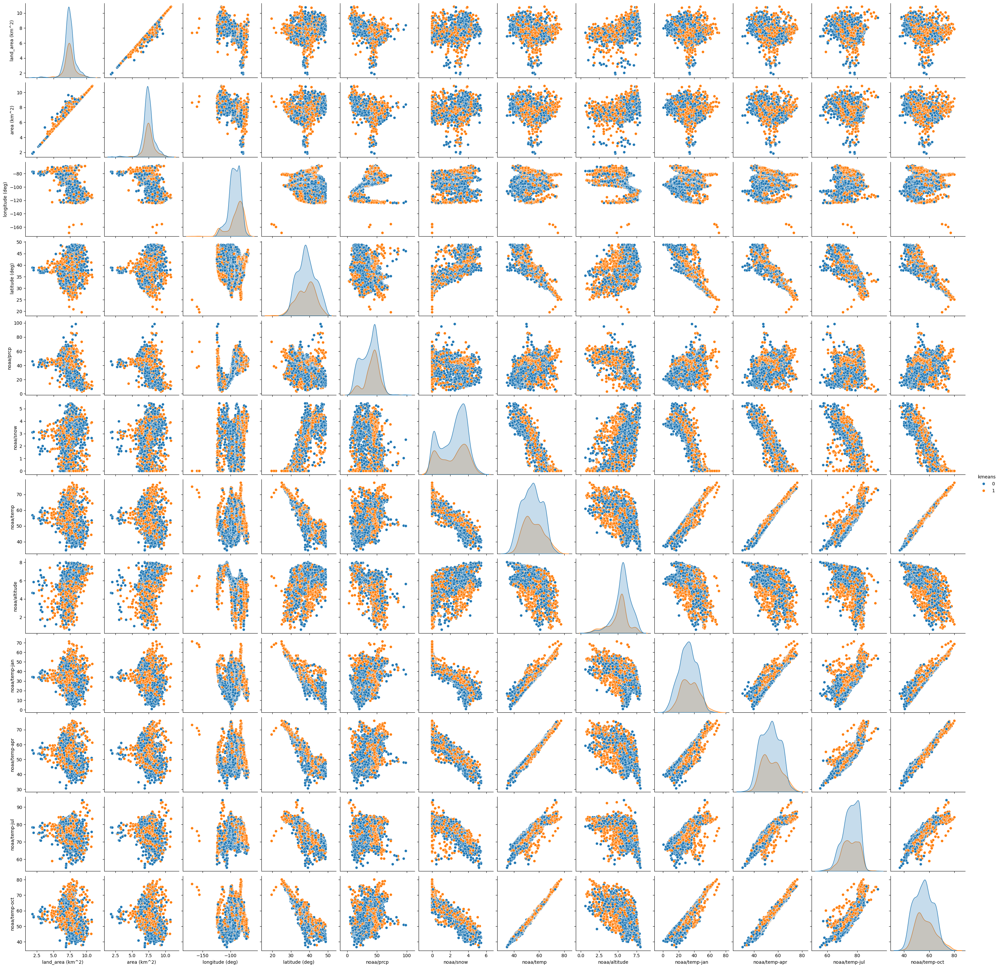

In [572]:
sns.pairplot(X_withelections[['land_area (km^2)', 'area (km^2)', 'longitude (deg)', 'latitude (deg)',
       'noaa/prcp', 'noaa/snow', 'noaa/temp', 'noaa/altitude', 'noaa/temp-jan',
       'noaa/temp-apr', 'noaa/temp-jul', 'noaa/temp-oct', 'kmeans']],hue='kmeans')

Nothing particularly illuminating here, but the plot of latidude vs longitude is fun because it looks like a little weird distorted map of the US! Some of the plots have some areas that have a higher concentration of orange, but there's a lot of overlap in all the plots.

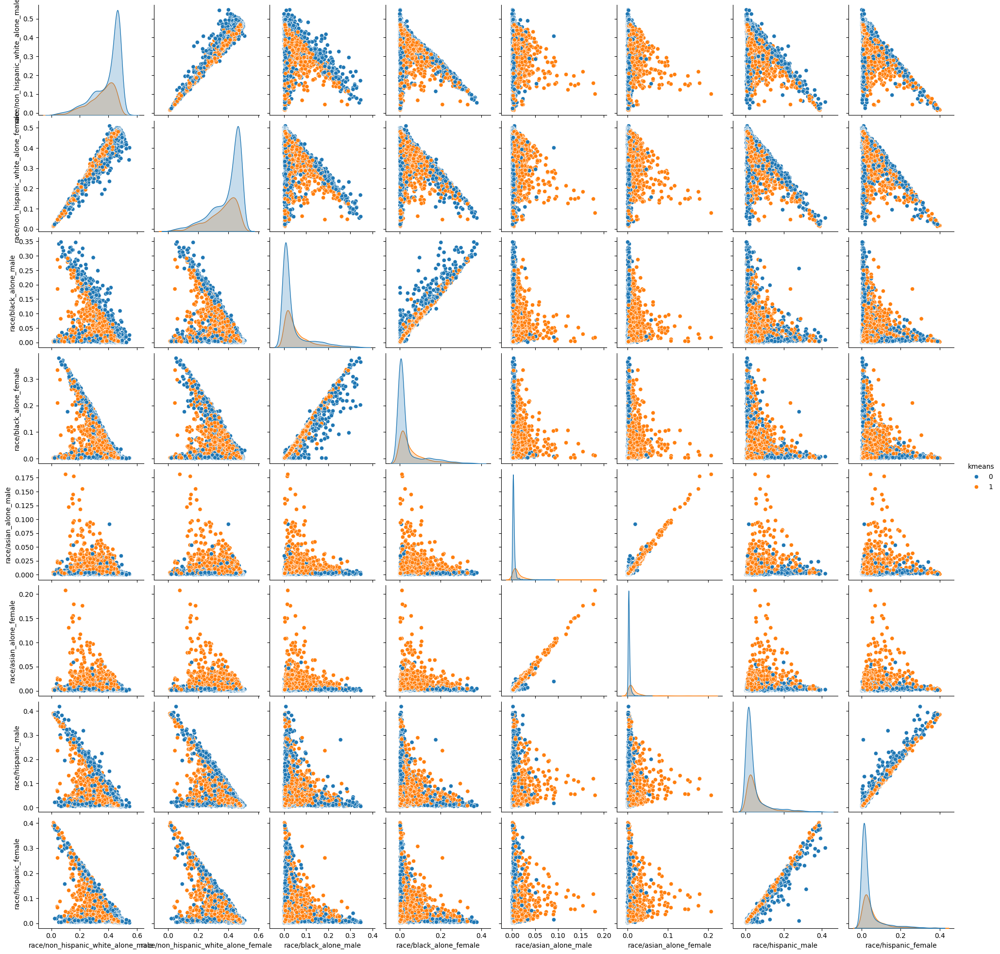

In [573]:
sns.pairplot(X_withelections[['race/non_hispanic_white_alone_male',
       'race/non_hispanic_white_alone_female', 'race/black_alone_male',
       'race/black_alone_female', 'race/asian_alone_male',
       'race/asian_alone_female', 'race/hispanic_male', 'race/hispanic_female','kmeans']],hue='kmeans')

Interesting, there are definitely some differences here with the race columns. Looks like the orange counties tend to have higher percentages of race columns besides white alone male. I also find the Hispanic female vs. male plot interesting. Unsurprisingly, the distribution for both clusters shows high correlation. But it seems that counties that are farther from the line (higher numbers of male than female) tend to be blue rather than orange. There's still a lot of overlap between everything so I can't read too much into this, but I do find it interesting.

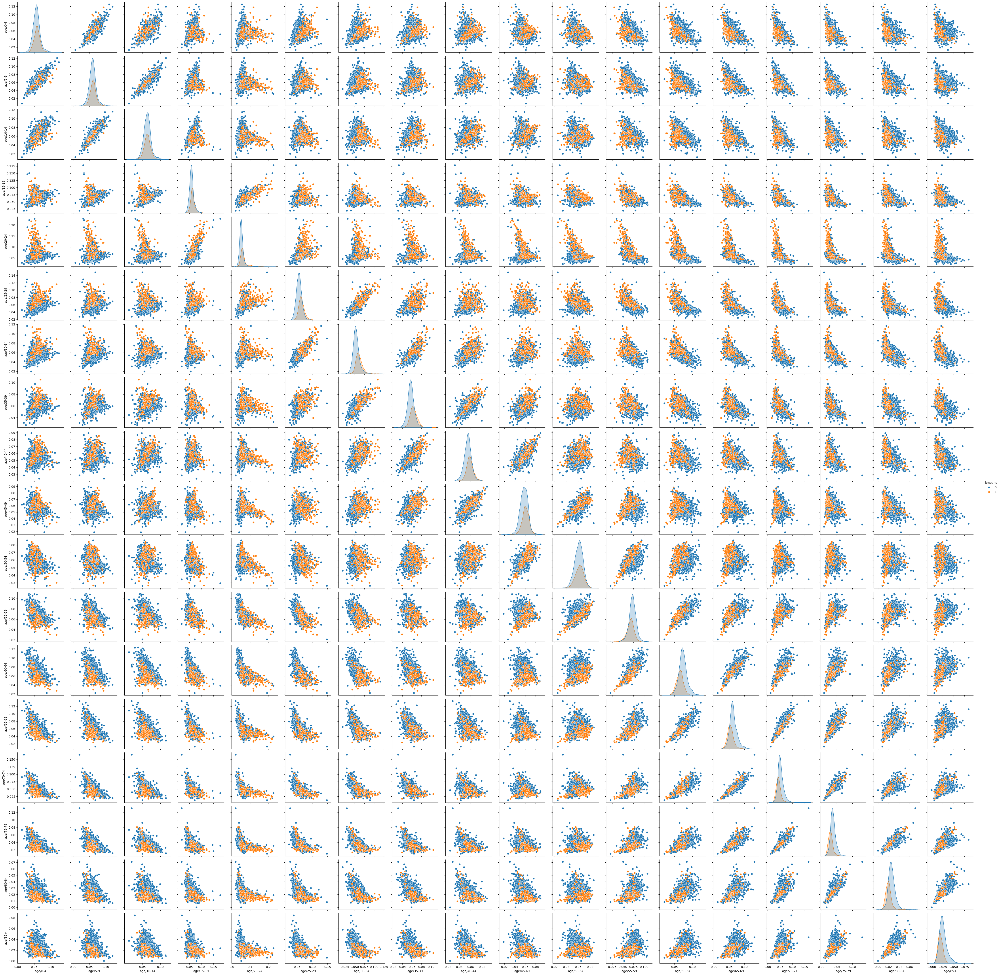

In [574]:
sns.pairplot(X_withelections[['age/0-4', 'age/5-9', 'age/10-14', 'age/15-19', 'age/20-24',
       'age/25-29', 'age/30-34', 'age/35-39', 'age/40-44', 'age/45-49',
       'age/50-54', 'age/55-59', 'age/60-64', 'age/65-69', 'age/70-74',
       'age/75-79', 'age/80-84', 'age/85+','kmeans']], hue='kmeans')

Okay plotting all the age columns with pairplot might have been a bit greedy and it's hard to read without zooming in, but this actually is a little interesting! The orange group tends to have higher population in the young adult ages(20s and 30s) and lower in the older ages (older than 50s). So I'm taking from the race and age plots that the small cluster chosen is younger and more diverse areas. I'll do one more set because I'm having fun looking at pair plots.

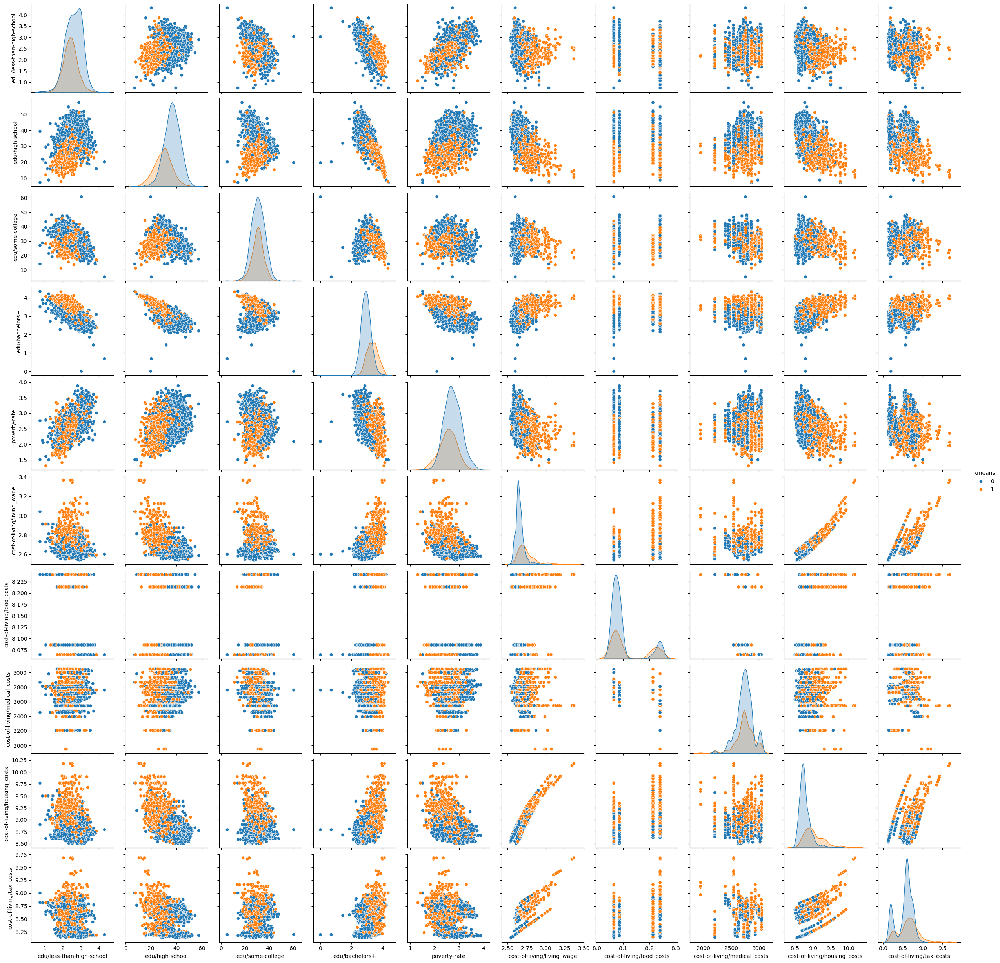

In [624]:
sns.pairplot(X_withelections[['edu/less-than-high-school', 'edu/high-school', 'edu/some-college',
       'edu/bachelors+', 'poverty-rate', 'cost-of-living/living_wage',
       'cost-of-living/food_costs', 'cost-of-living/medical_costs',
       'cost-of-living/housing_costs', 'cost-of-living/tax_costs','kmeans']],hue='kmeans')

Our orange cluster also appears to be higher education, higher housing costs. Putting it all together I'm guessing these counties are ones with large cities? Let's see what some of them are:

In [576]:
X_kmeans_elections

array([0, 1, 0, ..., 1, 1, 1], dtype=int32)

In [577]:
reduced_df[X_kmeans_elections==1][['name','state']].sample(15)

,name,state
800,calhoun county,AL
1770,albemarle county,VA
1637,washington county,OK
2156,ingham county,MI
2116,franklin county,NY
598,warren county,KY
2286,wayne county,IN
99,yakima county,WA
2828,washington county,MN
2924,calvert county,MD


I realize I don't know county names enough to know if these counties have larger cities or not! I'm not going to go down the rabbit hole to check all the counties and cities, but maybe that's something to look at another time.

What this is really emphasizing to me though is how much multicollinearity there is within my data. I knew that already but seeing it on the pair plots makes it very visual. I think that means that what I would really want to do with this data before would be to use dimensionality reduction. 

I will look at one other clustering method first, though, just to see what comes out.

## Clustering with DBSCAN

With DBSCAN, there are two hyperparameters (epsilon relating to the distance between points and the minimum number of points that have to be close enough). I'm going to plot the distance to the nearest neighbors distances to see what kind of distance might be reasonable to choose for epsilon.

(5.0, 12.0)

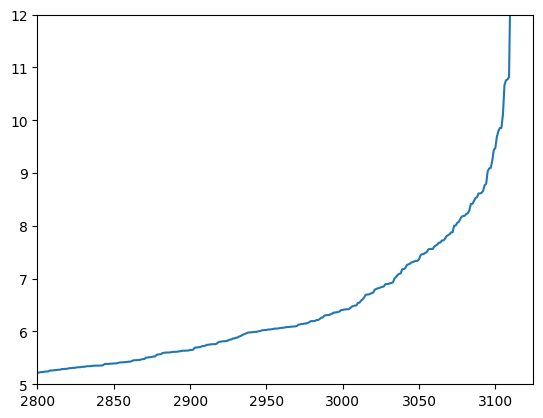

In [497]:
dataset=X_scaled
neighbors = NearestNeighbors(n_neighbors=20)
neighbors_fit = neighbors.fit(dataset)
distances, indices = neighbors_fit.kneighbors(dataset)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)
plt.xlim(2800,3125)
plt.ylim(5,12)

I've zoomed in to show the elbow of the plot ranges from about 5-11 in distance, so I'm going try values in that range to put in for DBSCAN and see how many clusters and noise points I get out. Since there are around 3000 counties, I'm going to print out the eps and min_samples for models that satisfy having more than one cluster and less than 500 points of noise. 

In [525]:
eps=[5,6,7,8,9,10,11]
min_samples=[5,10,15,20,30]
for e in eps:
    for samp in min_samples:
        cluster = DBSCAN(eps=e, min_samples=samp)
        cluster.fit(X_scaled)
        num_clusters = len(set(cluster.labels_) - set([-1]))
        noise_points=(cluster.labels_ == -1).sum()
        if (num_clusters>1)&(noise_points<500):
            print('eps ',e,'sample ',samp)
            print(f'DBSCAN found {len(set(cluster.labels_) - set([-1]))} clusters and {(cluster.labels_ == -1).sum()} points of noise.')

eps  6 sample  5
DBSCAN found 3 clusters and 221 points of noise.
eps  6 sample  10
DBSCAN found 3 clusters and 299 points of noise.
eps  7 sample  5
DBSCAN found 2 clusters and 102 points of noise.
eps  7 sample  10
DBSCAN found 2 clusters and 125 points of noise.
eps  7 sample  15
DBSCAN found 2 clusters and 156 points of noise.
eps  7 sample  20
DBSCAN found 2 clusters and 170 points of noise.


Let's see what some of these models look like compared with the 2020 election winners.

In [526]:
cluster = DBSCAN(eps=6, min_samples=10)
cluster.fit(X_scaled)

DBSCAN(eps=6, min_samples=10)

In [527]:
X_dbscan = cluster.labels_

In [528]:
pd.DataFrame(data={'winner2020':X_withelections['winner2020'].replace({0:'Dem',1:'Rep'}),'dbscan': X_dbscan}).groupby(['dbscan','winner2020']).size().to_frame().rename(columns={0:'Count'})

Count
dbscan winner2020       
-1     Dem           158
       Rep           141
 0     Dem           373
       Rep          2415
 1     Rep             4
 2     Dem             7
       Rep            14

Hmm well ok, this chose mostly one big cluster which is mostly republican, one tiny cluster of 4 republican counties, another small cluster that is 2/3 republican, and then a noise group which is more balanced between the two parties. I'll print out one more.

In [530]:
cluster = DBSCAN(eps=7, min_samples=20)
cluster.fit(X_scaled)

DBSCAN(eps=7, min_samples=20)

In [531]:
X_dbscan = cluster.labels_
pd.DataFrame(data={'winner2020':X_withelections['winner2020'].replace({0:'Dem',1:'Rep'}),'dbscan': X_dbscan}).groupby(['dbscan','winner2020']).size().to_frame().rename(columns={0:'Count'})

Count
dbscan winner2020       
-1     Dem           109
       Rep            61
 0     Dem           421
       Rep          2499
 1     Dem             8
       Rep            14

Okay, a little disappointing, once again almost everything is in the first cluster, and then a tiny cluster and a bigger noise group (which again contains a higher proportion of democrat counties). 
It might be interesting to explore what these counties are and what similarities they have to make them clustered together, but for the purposes of comparing with the elections, I don't think this is going to be terribly informative so I'm going to move on to dimensionality reduction.

# Dimensionality Reduction

I'm going to apply PCA to see how much I can reduce my already reduced data. But then I'm also going to go back to my original data with a few more columns to see if I should include those too.

In [504]:
pca = PCA()
pca.fit_transform(X_scaled)

array([[-5.58559520e+00, -2.08928659e+00, -1.50576172e+00, ...,
        -2.82656290e-03, -9.76778396e-05, -2.36634750e-03],
       [ 1.05167177e+01, -2.18923080e+00, -2.95687083e+00, ...,
        -2.00869533e-04, -1.27170268e-04,  2.23167486e-05],
       [-8.95887529e+00, -2.73719414e+00,  5.79488378e-01, ...,
        -2.02397311e-03, -2.44988197e-04, -8.12709439e-04],
       ...,
       [ 3.12515195e+00, -3.35769498e+00,  2.39682383e+00, ...,
         7.15740847e-05,  2.27278525e-04,  5.26272618e-05],
       [ 5.01059685e+00, -4.01491005e+00,  2.57134508e+00, ...,
        -4.66043481e-04, -8.02576223e-04, -3.85642451e-05],
       [ 7.99578883e+00, -3.59120210e+00,  2.21990862e+00, ...,
        -6.38201636e-04,  1.41794833e-04,  6.47185776e-04]])

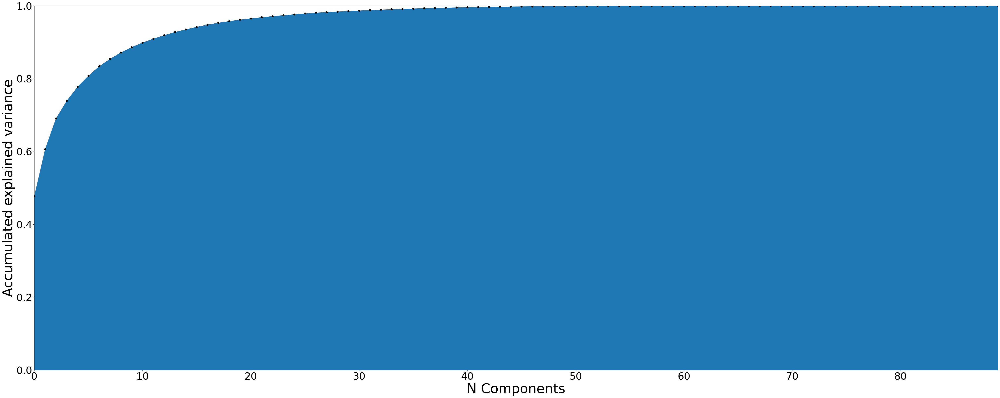

In [505]:
plot_explained_variance(pca)

Well that's pretty cool! It looks like we could have a pretty much perfect representation of the data with 40 components, cutting the number of features in half! I could even go lower, looks like only 50 would still be about 90% of the variance.

Let me see what features are important for the PCA components

In [532]:
pca_list = list()
feature_weight_list = list()

print('model',pca,'var',pca.explained_variance_ratio_.sum())
    
    # Calculate and store feature importances
abs_feature_values = np.abs(pca.components_).sum(axis=0)
feature_weights=pd.DataFrame({'features': X.columns,
                              'values':abs_feature_values/abs_feature_values.sum()})

model PCA() var 1.0000000000000002


Text(0.5, 0, 'Relative Importance')

<Figure size 1200x600 with 0 Axes>

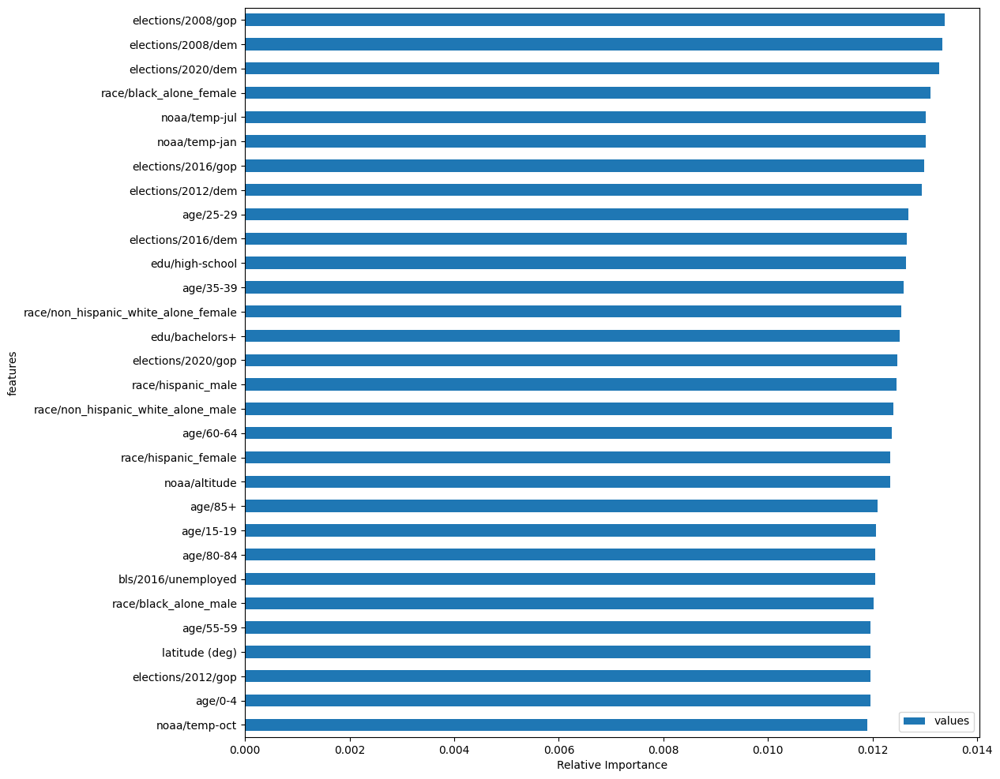

In [533]:
plt.figure(figsize=[12,6])
feature_weights.sort_values(by='values',ascending=True).tail(30).plot(kind='barh',figsize=[12,12],x='features')
plt.xlabel('Relative Importance')

Interesting mix of features chosen!

## Classification Models with PCA
I'm going to rerun some of my classification models now with the PCA components.

In [579]:
X_with_elections = X_withelections.drop(columns=['winner2020', 'kmeans'])

In [580]:
X = X_with_elections.drop(columns=['winner2008','winner2012','winner2016'])
y = reduced_df['winner2020']

In [581]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state = rs)
X_train_with_elections, X_test_with_elections, y_train, y_test = train_test_split(
    X_with_elections, y, test_size=0.2, stratify=y, random_state = rs)

In [582]:
scaler = StandardScaler()

In [583]:
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [584]:
X_train_elections_scaled = scaler.fit_transform(X_train_with_elections)
X_test_elections_scaled = scaler.transform(X_test_with_elections)

In [585]:
pca = PCA(n_components=30)
pca.fit(X_train_scaled)
X_train_pca = pca.transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

In [586]:
def grid_search_lr(X_train, y_train):
    params_grid = {
        'class_weight': ['balanced', {0:0.5, 1:0.5}, {0:0.6, 1:0.4}, {0:0.75, 1:0.25}, {0:0.8, 1:0.2}],
        'penalty': ['l1','l2'],
        'solver': ['liblinear']
    }
    lr_model = LogisticRegression(random_state=rs, max_iter=500)
    grid_search = GridSearchCV(estimator = lr_model, 
                           param_grid = params_grid, 
                           scoring='f1',
                           cv = 5, verbose = 1)
    grid_search.fit(X_train, y_train)
    print(grid_search.best_params_)
    return grid_search

In [587]:
search_lr=grid_search_lr(X_train_pca,y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
{'class_weight': {0: 0.5, 1: 0.5}, 'penalty': 'l2', 'solver': 'liblinear'}


In [588]:
y_pred = search_lr.predict(X_test_pca)

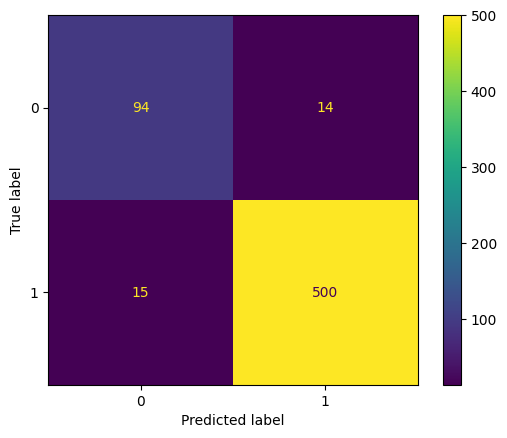

In [589]:
cf = confusion_matrix(y_test, y_pred) #, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cf)
disp.plot()

In [590]:
print_model_metrics(y_test,y_pred)

Accuracy is: 0.95
Precision is: 0.86
Recall is: 0.87
Fscore is: 0.87
AUC is: 0.92


Not great, I don't think that the PCA helped this model be any better than the original. I'll try including the election columns.
(Note: I also tried different numbers of components in the PCA step - 10, 15, 20. None really did better than this so I left it at 3

In [591]:
pca_elections = PCA(n_components=30)
pca_elections.fit(X_train_elections_scaled)
X_train_pca_elections = pca_elections.transform(X_train_elections_scaled)
X_test_pca_elections = pca_elections.transform(X_test_elections_scaled)

In [592]:
search_lr_withelections=grid_search_lr(X_train_pca_elections,y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
{'class_weight': {0: 0.6, 1: 0.4}, 'penalty': 'l1', 'solver': 'liblinear'}


In [593]:
y_pred = search_lr_withelections.predict(X_test_pca_elections)
print_model_metrics(y_test,y_pred)

Accuracy is: 0.97
Precision is: 0.91
Recall is: 0.89
Fscore is: 0.90
AUC is: 0.94


So with elections does a little better, but really pretty similar to how it did with the original model.

#### Random Forest

In [612]:
def grid_search_rf(X_train, y_train):
    params_grid = {
    'max_depth': [3, 5,10],
    'n_estimators': [25, 50,100],
    'min_samples_split': [5, 10],
    'class_weight': ['balanced', {1:0.5, 0:0.5},{1:0.3, 0:0.7}]
    }
    rf_model = RandomForestClassifier(random_state=rs)
    grid_search = GridSearchCV(estimator = rf_model, 
                           param_grid = params_grid, 
                           scoring='f1',
                           cv = 5, verbose = 1)
    grid_search.fit(X_train, y_train)
    print(grid_search.best_params_)
    return grid_search

In [613]:
search_rf=grid_search_rf(X_train_pca, y_train)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
{'class_weight': {1: 0.3, 0: 0.7}, 'max_depth': 10, 'min_samples_split': 10, 'n_estimators': 100}


In [614]:
y_pred = search_rf.predict(X_test_pca)

In [615]:
print_model_metrics(y_test, y_pred)

Accuracy is: 0.92
Precision is: 0.85
Recall is: 0.65
Fscore is: 0.74
AUC is: 0.81


Not as good. I'm going to try with lower number of components in the PCA. (Note: I tried a few different numbers but for simplicity I'm going to just show 10)

In [616]:
# PCA 10
pca_10 = PCA(n_components=10)
pca_10.fit(X_train_scaled)
X_train_pca_10 = pca_10.transform(X_train_scaled)
X_test_pca_10 = pca_10.transform(X_test_scaled)

In [617]:
search_rf_pca10=grid_search_rf(X_train_pca_10, y_train)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
{'class_weight': 'balanced', 'max_depth': 10, 'min_samples_split': 5, 'n_estimators': 100}


In [618]:
y_pred = search_rf_pca10.predict(X_test_pca_10)
print_model_metrics(y_test,y_pred)

Accuracy is: 0.92
Precision is: 0.83
Recall is: 0.70
Fscore is: 0.76
AUC is: 0.84


The precision is lower but the other metrics are a little better using the smaller number of principal components. (Still not really better than my original models without PCA though). I'll include election columns from previous years and repeat this process.

In [619]:
search_rf_elections=grid_search_rf(X_train_pca_elections, y_train)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
{'class_weight': {1: 0.3, 0: 0.7}, 'max_depth': 10, 'min_samples_split': 10, 'n_estimators': 100}


In [620]:
y_pred = search_rf_elections.predict(X_test_pca_elections)
print_model_metrics(y_test,y_pred)

Accuracy is: 0.96
Precision is: 0.92
Recall is: 0.84
Fscore is: 0.88
AUC is: 0.91


In [621]:
pca_elections_15 = PCA(n_components=15)
pca_elections_15.fit(X_train_elections_scaled)
X_train_pca_elections_15 = pca_elections_15.transform(X_train_elections_scaled)
X_test_pca_elections_15 = pca_elections_15.transform(X_test_elections_scaled)

In [622]:
search_rf_elections_15=grid_search_rf(X_train_pca_elections_15, y_train)

Fitting 5 folds for each of 54 candidates, totalling 270 fits
{'class_weight': 'balanced', 'max_depth': 10, 'min_samples_split': 10, 'n_estimators': 50}


In [623]:
y_pred = search_rf_elections_15.predict(X_test_pca_elections_15)
print_model_metrics(y_test,y_pred)

Accuracy is: 0.96
Precision is: 0.90
Recall is: 0.89
Fscore is: 0.89
AUC is: 0.93


This model is slightly better but still not as good as my original ones or the one created using logistic regression. I might not be including the best hyperparameters, but I'm going to leave this alone for now.

# Summary

## Data Description

The data set used was a compiled set of county-level data about counties in the United States. The initial data set had 3142 entries (separate counties/regions) and 237 different columns, including various data about demographics (e.g. age, race, and gender), geography (e.g. latitude, longitude, weather), health, industry, education, income, and unemployment. The data also includes the number of voters in each county who voted for Democratic or Republican candidates in the past four federal elections. 

## Data Exploration and Feature Engineering

I took a few different steps to prepare the data for further analysis.
1. I reduced the data set by removing some columns that had many null values or ones that I was not sure I was interested in for the purposes of this project. 
2. I created columns to represent the election winner for each county rather than the number of votes for each party.
3. I replaced very skewed columns using a log transform. 
4. I scaled the data using the standard scaler.

## Unsupervised Modeling Techniques

I used three different unsupervised learning techniques to explore this data. 
1. First, I performed clustering using KMeans clustering and selected two clusters. I was interested in seeing if this clustering method would separate counties into Democrat or Republican leaning counties. However, the results were not so clearly related to the voting patterns. While one of the clusters was much larger and had a much greater proportion of Republican counties, the other smaller cluster was more balanced between the two parties. Using pair plotting to explore the clusters, I found that the smaller cluster of counties tended to be more diverse (lower percentage of white males), included more young adults, higher education, and higher housing costs. My hypothesis is that this group of counties includes more cities, while the other counties might be more rural.
2. Next I used DBSCAN to create clusters. I provided a few different options for the hyperparameters (epsilon and minimum samples) and for each one, I printed the number of clusters and number of noise points. For a couple of different options, I compared the results with the election winners. In each case, it seemed that most counties were placed in one huge cluster, and then there would be one or two small (sometimes very tiny) clusters and then noise. It was interesting that in some cases, the noise set was more balanced between the parties while the large cluster had way more republican counties, similar to how KMeans divided the counties. (However, I did not do a direct comparison of the clusters chose by each.) 
3. Finally, I explored how I could use dimensionality reduction (PCA) in combination with classification methods to classify the counties based on the 2020 election winners in each county. I had previously done a classification project using this data set, and I was interested in seeing whether applying the dimensionality reduction first would help create better classification models. Long story short, I was unable to get any better models, but could get roughly comparable results. It was still interesting, however, to see the features chosen by PCA as the most important. And it was interesting that while I started with about 90 columns, using PCA could explain about 90% of the variance with just 15 columns.

## Key Findings and Insights

At least with the data I chose in this set, the counties do not clearly and easily cluster based on which party received the majority of votes in 2020. This would probably change (at least somewhat) if I had chosen different columns to keep or discard. For example, I could exclude columns about weather and precipitation in my data set, which I wouldn't expect to be strongly clustered along party lines. And I could include information about COVID, which might be more relevant. 

I found that using clustering techniques tended to create one large cluster and then smaller (or noise) clusters. Although the party breakdown was different in these two groups (vast majority republican vs. more balanced), the clusters did not fall along party lines.

With the dimensionality reduction techniques that I tried, I was not able to create better classification models for the 2020 election than when I didn't use PCA. This might again be because of the specific data columns I chose, or possibly the hyperparameters chosen. Regardless, it was interesting to see which columns were more important in PCA.

## Next Steps

There are quite a few things that could be done next to improve or deepen this analysis. 
1. Examine the effect of skew and skew corrections. Here I show results using the log transformation, but I am not actually sure that this benefitted the analysis.
2. Choose different columns to include or exclude, as mentioned above.
3. Explore which counties fell into different clusters to better understand what is similar about the ones in the same cluster.
4. Compare the exact counties in the clusters chosen by KMeans and DBSCAN to understand if they are choosing similar clusters.